In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from time import time
import joblib

import nltk
from nltk.corpus import stopwords

import pyLDAvis
import pyLDAvis.lda_model

from gensim.models import Word2Vec
from sklearn.model_selection import train_test_split
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.metrics import jaccard_score, accuracy_score
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.decomposition import LatentDirichletAllocation, NMF
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

import mlflow
import mlflow.sklearn
from datetime import datetime

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('words')
nltk.download('wordnet')

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pkg_resources/__init__.py:121: DeprecationWarning: pkg_resources is deprecated as an API
  warnings.warn("pkg_resources is deprecated as an API", DeprecationWarning)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pkg_resources/__init__.py:2870: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('mpl_toolkits')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pkg_resources/__init__.py:2870: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_names

True

In [2]:
# L'endroit où les données seront stockées
mlflow.set_tracking_uri(os.getenv("MLFLOW_TRACKING_URI", "http://0.0.0.0:5000"))
mlflow.set_experiment("Catégoriser automatiquement des questions")  

<Experiment: artifact_location='/Users/atfehranacz53_cb/Documents/OC/projet_5/mlruns/1', creation_time=1724405173849, experiment_id='1', last_update_time=1724405173849, lifecycle_stage='active', name='Catégoriser automatiquement des questions', tags={}>

### Fonction pour logger les paramètres, métriques, tags et artifacts dans MLflow.


In [3]:
def log_mlflow_run(run_name, parameters, metrics, model=None, model_name=None, tags=None, artifacts=None):

    try:
        # Check if there's an active run and end it if necessary
        if mlflow.active_run():
            mlflow.end_run()
        
        # Start a new MLflow run
        mlflow.start_run(run_name=run_name)
        
        # Log parameters
        if parameters:
            for key, value in parameters.items():
                mlflow.log_param(key, value)
        
        # Log metrics
        if metrics:
            for key, value in metrics.items():
                mlflow.log_metric(key, value)

        # Log tags
        if tags:
            mlflow.set_tags(tags)

        # Log artifacts
        if artifacts:
            for artifact_name, artifact_path in artifacts.items():
                mlflow.log_artifact(artifact_path, artifact_name)

        # Log the model
        if model and model_name:
            mlflow.sklearn.log_model(model, model_name)
        
        # Log the run completion timestamp
        mlflow.log_param("run_completed_at", str(datetime.now()))

    except Exception as e:
        # Log the error as a tag to help in debugging
        mlflow.set_tag("run_error", str(e))
        print(f"Erreur lors de la journalisation dans MLflow: {e}")
        
    finally:
        # Ensure the run is always ended, even in case of an error
        mlflow.end_run()


In [4]:
df_query = pd.read_csv("data/df_query.csv")

In [5]:
condition = df_query.Title.isna()
df_query.loc[condition, 'Title'] = df_query.loc[condition, 'Body']

condition = df_query.Body.isna()
df_query.loc[condition, 'Body'] = df_query.loc[condition, 'Title']


In [6]:
df_query = df_query.dropna(subset=['Title', 'Body'])

In [7]:
df_query

,Title,Body,Tags,Score,ViewCount,AnswerCount
0,process sorted array fast process unsorted array,c++ code sort datum time region make primary l...,java prediction c++ branch cpu architecture pe...,27284,1890740,25
1,delete git branch locally remotely,fail attempt delete remote branch pre class la...,control git push branch version remote,20374,11680196,41
2,operator c++,read href http group google com group comp lan...,c++ standard format compliance operator code,10165,1016567,26
3,force git pull overwrite local file,force overwrite local file code git pull code ...,control git pull version fetch overwrite,9710,8669682,54
4,stack heap,stack heap locate physically computer memory e...,heap dynamic structure memory allocation data ...,9441,1945819,31
...,...,...,...,...,...,...
49995,microsoft azure different subnet vnet,microsoft azure different subnet vnet azure ne...,cloud machine service azureportal azure networ...,5,26861,3
49996,jquery validation rules statement,code work need basically field length check zi...,ajax jquery validationrule javascript validate,5,35834,2
49997,material datepicker custom renderinput,recently start material react typescript proje...,material reactjs typescript javascript datepicker,5,25504,2
49998,use request post proxy authentication python,pre code import beautifulsoup import request r...,post python beautifulsoup proxy http,5,34425,1


In [8]:
df_query_train, df_query_val = train_test_split(df_query, test_size=0.5, random_state=88)

In [9]:
vectorizer = TfidfVectorizer(max_features=500, stop_words='english')

bow = vectorizer.fit_transform(df_query_train.Title + ' ' + df_query_train.Body)
bow_val = vectorizer.transform(df_query_val.Title + ' ' + df_query_val.Body)

X = pd.DataFrame(bow.toarray(), index=df_query_train.index, columns=vectorizer.get_feature_names_out())
X_val = pd.DataFrame(bow_val.toarray(), index=df_query_val.index, columns=vectorizer.get_feature_names_out())


In [10]:
binarizer = CountVectorizer(binary=True, max_features=100, stop_words='english')

bow_cible = binarizer.fit_transform(df_query_train.Tags)
bow_val_cible = binarizer.transform(df_query_val.Tags)

y = pd.DataFrame(bow_cible.toarray(), index=df_query_train.index, columns=binarizer.get_feature_names_out())
y_val = pd.DataFrame(bow_val_cible.toarray(), index=df_query_val.index, columns=binarizer.get_feature_names_out())

In [11]:
with mlflow.start_run(run_name="TfidfVectorizer") as run:
    # Enregistrer le vectorizer en tant qu'artefact
    vectorizer_path = "vectorizer.pkl"
    joblib.dump(vectorizer, vectorizer_path)
    mlflow.log_artifact(vectorizer_path, "tfidf_vectorizer")
    os.remove(vectorizer_path)

2024/08/29 10:40:43 INFO mlflow.tracking._tracking_service.client: 🏃 View run TfidfVectorizer at: http://0.0.0.0:5000/#/experiments/1/runs/081864e183a54a2db9522707ad621bc6.
2024/08/29 10:40:43 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://0.0.0.0:5000/#/experiments/1.


In [12]:
with mlflow.start_run(run_name="Binarizer") as run:
    # Enregistrer le binarizer en tant qu'artefact
    binarizer_path = "binarizer.pkl"
    joblib.dump(binarizer, binarizer_path)
    mlflow.log_artifact(binarizer_path, "binarizer")
    os.remove(binarizer_path)

2024/08/29 10:40:43 INFO mlflow.tracking._tracking_service.client: 🏃 View run Binarizer at: http://0.0.0.0:5000/#/experiments/1/runs/a6da68aa450e4e9f8948baa7f4b61411.
2024/08/29 10:40:43 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://0.0.0.0:5000/#/experiments/1.


# Classification avec Bag-of-words TF-IDF


## REGRESSION LOGISTIQUE

In [13]:
def coverage_score(predictions, actuals):
    # Assuming a coverage score calculation based on overlap of predicted and actual tags
    total_tags = sum(len(tags.split()) for tags in actuals)
    covered_tags = sum(len(set(pred.split()) & set(act.split())) for pred, act in zip(predictions, actuals))
    return covered_tags / total_tags if total_tags > 0 else 0


In [14]:
classifier = OneVsRestClassifier(LogisticRegression())
classifier.fit(X, y)
y_pred = classifier.predict(X_val)

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packa

In [ ]:
score_reference = jaccard_score(y_val, y_pred, average='weighted')
score_reference

In [ ]:
df_query_val

In [ ]:
tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
coverage_reference = coverage_score(tags_pred, df_query_val.Tags)
coverage_reference

In [ ]:
params = {'algorithme' : 'Regression_logistique'}
metrics = {'jaccard_score' : score_reference,
           'taux_de_couverture' : coverage_reference}
tags = {'Dataset' : 'BOW_tfidf', 'algorithme' : 'Regression_logistique'}

log_mlflow_run('Regression logistique (TF-IDF)', params, metrics, tags=tags, model=classifier, model_name='Regression_logistique')

## SGDClassifier AVEC UNE PÉNALITÉ L2

In [ ]:
alphas = np.logspace(-8, -4, 10)
score = []
coverage = []

for alpha in alphas:
    classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha, penalty='l2', loss='log_loss', random_state=72))
    classifier.fit(X, y)
    
    y_pred = classifier.predict(X_val)
    score.append(jaccard_score(y_val, y_pred, average='weighted'))
    
    tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
    coverage.append(coverage_score(tags_pred, df_query_val.Tags))

In [ ]:
sns.set(style='darkgrid')
fig, axe = plt.subplots(1,2,figsize = (10,5))
axe = axe.flatten()
sns.lineplot(x=np.log(alphas), y=score, ax=axe[0], color='blue')
sns.lineplot(x=np.log(alphas), y=score_reference, ax=axe[0], color='red')
axe[0].set_xlabel('alpha')
axe[0].set_ylabel('Jaccard score')
sns.lineplot(x=np.log(alphas), y=coverage, ax=axe[1], color='green')
sns.lineplot(x=np.log(alphas), y=coverage_reference, ax=axe[1], color='red')
axe[1].set_xlabel('alpha')
axe[1].set_ylabel('Taux de couverture')
plt.show()

In [ ]:
alpha_optimal = alphas[np.argmax(coverage)]
alpha_optimal

In [ ]:
score[np.argmax(coverage)]

In [ ]:
max(coverage)

In [ ]:
classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha_optimal, penalty='l2', loss='log_loss', random_state=72))
classifier.fit(X, y)

In [ ]:
params = {'algorithme' : 'SGDClassifier', 'loss' : 'log_loss', 'penalty' : 'l2', 'alpha_optimal' : alpha_optimal}
metrics = {'jaccard_score' : score[np.argmax(coverage)],
           'taux_de_couverture' : max(coverage)}
tags = {'Dataset' : 'BOW_tfidf', 'algorithme' : 'SGDClassifier'}

log_mlflow_run('SGDClassifier_l2 (TF-IDF)', params, metrics, tags=tags, model=classifier, model_name='SGDClassifier')

# Classification avec Embedding Word2Vec


## REGRESSION LOGISTIQUE

In [ ]:
from gensim.models import Word2Vec

In [ ]:
sentences = [title.split() for title in df_query_train.Title] + [question.split() for question in df_query_train.Body]
embedding = Word2Vec(sentences, vector_size=100, min_count=1, sg=1, window=7)

In [ ]:
embedding.wv.most_similar('tensorflow')

In [ ]:
def get_vector(embedding, text):
    return np.mean([embedding.wv[word] for word in text.split() if word in embedding.wv], axis=0)

In [ ]:
X = pd.DataFrame((df_query_train.Title + ' ' + df_query_train.Body).apply(lambda x: get_vector(embedding, x)).tolist(), index=df_query_train.index)
X_val = pd.DataFrame((df_query_val.Title + ' ' + df_query_val.Body).apply(lambda x: get_vector(embedding, x)).tolist(), index=df_query_val.index)

In [ ]:
classifier = OneVsRestClassifier(LogisticRegression())
classifier.fit(X, y)
y_pred = classifier.predict(X_val)

In [ ]:
score_reference = jaccard_score(y_val, y_pred, average='weighted')
score_reference

In [ ]:
tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
coverage_reference = coverage_score(tags_pred, df_query_val.Tags)
coverage_reference

In [ ]:
params = {'algorithme' : 'LogisticRegression'}
metrics = {'jaccard_score' : score_reference,
           'taux_de_couverture' : coverage_reference}
tags = {'Dataset' : 'Word2Vec', 'algorithme' : 'SGDClassifier'}

log_mlflow_run('Regression logistique (Word2Vec)', params, metrics, tags=tags, model=classifier, model_name='LogisticRegression')

## SGDClassifier AVEC UNE PÉNALITÉ L2

In [ ]:
alphas = np.logspace(-8, -4, 10)
score = []
coverage = []

for alpha in alphas:
    classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha, penalty='l2', loss='log_loss', random_state=72))
    classifier.fit(X, y)
    
    y_pred = classifier.predict(X_val)
    score.append(jaccard_score(y_val, y_pred, average='weighted'))
    
    tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
    coverage.append(coverage_score(tags_pred, df_query_val.Tags))

In [ ]:
sns.set(style='darkgrid')
fig, axe = plt.subplots(1,2,figsize = (10,5))
axe = axe.flatten()
sns.lineplot(x=np.log(alphas), y=score, ax=axe[0], color='blue')
sns.lineplot(x=np.log(alphas), y=score_reference, ax=axe[0], color='red')
axe[0].set_xlabel('alpha')
axe[0].set_ylabel('Jaccard score')
sns.lineplot(x=np.log(alphas), y=coverage, ax=axe[1], color='green')
sns.lineplot(x=np.log(alphas), y=coverage_reference, ax=axe[1], color='red')
axe[1].set_xlabel('alpha')
axe[1].set_ylabel('Taux de couverture')
plt.show()

In [ ]:
alpha_optimal = alphas[np.argmax(coverage)]
print(score[np.argmax(coverage)])
print(max(coverage))

In [ ]:
classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha_optimal, penalty='l2', loss='log_loss', random_state=72))
classifier.fit(X, y)

In [ ]:
params = {'algorithme' : 'SGDClassifier', 'loss' : 'log_loss', 'penalty' : 'l2', 'alpha_optimal' : alpha_optimal}
metrics = {'jaccard_score' : score[np.argmax(coverage)],
           'taux_de_couverture' : max(coverage)}
tags = {'Dataset' : 'Word2Vec', 'algorithme' : 'SGDClassifier'}

log_mlflow_run('SGDClassifier_l2 (Word2Vec)', params, metrics, tags=tags, 
                  model=classifier, model_name='SGDClassifier')

## Classification avec Embedding BERT

### Regression logistique

In [ ]:
from transformers import DistilBertTokenizer, DistilBertModel
import torch

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
def get_bert_embeddings(texts, batch_size=16):

    tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
    model = DistilBertModel.from_pretrained('distilbert-base-uncased')

    embeddings = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i + batch_size]
        inputs = tokenizer(batch_texts, return_tensors='pt', padding=True, truncation=True, max_length=32)
        with torch.no_grad():
            outputs = model(**inputs)
        embeddings.append(outputs.last_hidden_state.mean(dim=1).numpy())

    return np.concatenate(embeddings, axis=0)

In [ ]:
# Ensure the inputs are correctly formatted as lists of strings
train_texts = (df_query_train.Title + ' ' + df_query_train.Body).tolist()
val_texts = (df_query_val.Title + ' ' + df_query_val.Body).tolist()

# Obtain the embeddings for the training and validation sets
bert_train = get_bert_embeddings(train_texts)
bert_val = get_bert_embeddings(val_texts)


In [ ]:
classifier = OneVsRestClassifier(LogisticRegression(max_iter=300))
classifier.fit(bert_train, y)
y_pred = classifier.predict(bert_val)

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packa

In [ ]:
score_reference = jaccard_score(y_val, y_pred, average='weighted')
score_reference

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packa

0.3523233823021914

In [ ]:
tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
coverage_reference = coverage_score(tags_pred, df_query_val.Tags)
coverage_reference

0.1632644069787934

In [ ]:
params = {'algorithme' : 'LogisticRegression'}
metrics = {'jaccard_score' : score_reference,
           'taux_de_couverture' : coverage_reference}
tags = {'Dataset' : 'BERT', 'algorithme' : 'LogisticRegression'}

log_mlflow_run('Regression logistique (BERT)', params, metrics, tags=tags, model=classifier, model_name='LogisticRegression')

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/importlib/__init__.py:126: DeprecationWarning: The distutils package is deprecated and slated for removal in Python 3.12. Use setuptools or check PEP 632 for potential alternatives
  return _bootstrap._gcd_import(name[level:], package, level)
2024/08/23 17:02:13 WARNING mlflow.models.model: Input example should be provided to infer model signature if the model signature is not provided when logging the model.
2024/08/23 17:02:13 INFO mlflow.tracking._tracking_service.client: 🏃 View run Regression logistique (BERT) at: http://0.0.0.0:5000/#/experiments/1/runs/2d5769a579f6467ca3a86cb07e1f1279.
2024/08/23 17:02:13 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://0.0.0.0:5000/#/experiments/1.


## SGDClassifier AVEC UNE PÉNALITÉ L2

In [ ]:
alphas = np.logspace(-8, -4, 10)
score = []
coverage = []

for alpha in alphas:
    classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha, penalty='l2', loss='log_loss', random_state=72))
    classifier.fit(bert_train, y)
    
    y_pred = classifier.predict(bert_val)
    score.append(jaccard_score(y_val, y_pred, average='weighted'))
    
    tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
    coverage.append(coverage_score(tags_pred, df_query_val.Tags))

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packa

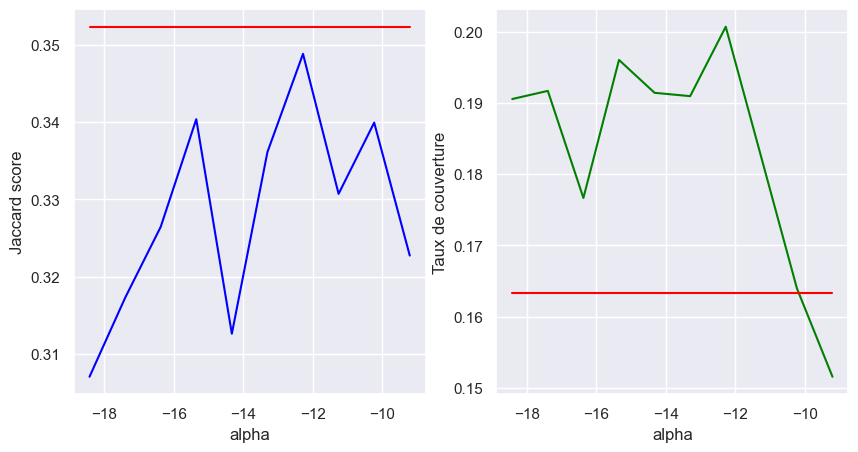

In [ ]:
sns.set(style='darkgrid')
fig, axe = plt.subplots(1,2,figsize = (10,5))
axe = axe.flatten()
sns.lineplot(x=np.log(alphas), y=score, ax=axe[0], color='blue')
sns.lineplot(x=np.log(alphas), y=score_reference, ax=axe[0], color='red')
axe[0].set_xlabel('alpha')
axe[0].set_ylabel('Jaccard score')
sns.lineplot(x=np.log(alphas), y=coverage, ax=axe[1], color='green')
sns.lineplot(x=np.log(alphas), y=coverage_reference, ax=axe[1], color='red')
axe[1].set_xlabel('alpha')
axe[1].set_ylabel('Taux de couverture')
plt.show()

In [ ]:
alpha_optimal = alphas[np.argmax(coverage)]
alpha_optimal

4.641588833612773e-06

In [ ]:
score[np.argmax(coverage)]

0.34881761784518645

In [ ]:
max(coverage)

0.20071374023380134

In [ ]:
classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha_optimal, penalty='l2', loss='log_loss', random_state=72))
classifier.fit(bert_train, y)

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/pandas/core/algorithms.py:1743: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  return lib.map_infer(values, mapper, convert=convert)
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packa

OneVsRestClassifier(estimator=SGDClassifier(alpha=4.641588833612773e-06,
                                            loss='log_loss', random_state=72))

In [ ]:
params = {'algorithme' : 'SGDClassifier', 'loss' : 'log_loss', 'penalty' : 'l2', 'alpha_optimal' : alpha_optimal}
metrics = {'jaccard_score' : score[np.argmax(coverage)],
           'taux_de_couverture' : max(coverage)}
tags = {'Dataset' : 'BERT', 'algorithme' : 'SGDClassifier'}

log_mlflow_run('SGDClassifier_l2 (BERT)', params, metrics, tags=tags, model=classifier, model_name='SGDClassifier')

/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/_distutils_hack/__init__.py:18: UserWarning: Distutils was imported before Setuptools, but importing Setuptools also replaces the `distutils` module in `sys.modules`. This may lead to undesirable behaviors or errors. To avoid these issues, avoid using distutils directly, ensure that setuptools is installed in the traditional way (e.g. not an editable install), and/or make sure that setuptools is always imported before distutils.
  warnings.warn(
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
/opt/homebrew/Caskroom/miniconda/base/envs/fastsurfer/lib/python3.10/importlib/__init__.py:126: DeprecationWarning: The distutils package is deprecated and slated for removal in Python 3.12. Use setuptools or check PEP 632 for potential alternatives


# Classification avec Embedding USE


In [ ]:
import tensorflow_hub as hub

# Charger le modèle USE
model = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")


ValueError: Trying to load a model of incompatible/unknown type. '/var/folders/w7/qz_zwc2x3js4q6gsw1fw_mlr0000gp/T/tfhub_modules/063d866c06683311b44b4992fd46003be952409c' contains neither 'saved_model.pb' nor 'saved_model.pbtxt'.

In [ ]:

# Fonction pour obtenir les embeddings USE (par lots)
def get_use_embeddings(texts, batch_size=8):
    all_embeddings = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i + batch_size]
        batch_embeddings = model(batch_texts).numpy()
        all_embeddings.append(batch_embeddings)
    return np.concatenate(all_embeddings, axis=0)


## Regression logistique

In [ ]:

# Obtenir les embeddings pour l'ensemble d'entraînement et de test
use_train = get_use_embeddings((df_query_train.Title + ' ' + df_query_train.Body).tolist())

In [ ]:
use_val = get_use_embeddings((df_query_val.Title + ' ' + df_query_val.Body).tolist())

In [ ]:
classifier = OneVsRestClassifier(LogisticRegression())
classifier.fit(use_train, y)
y_pred = classifier.predict(use_val)

In [ ]:
score_reference = jaccard_score(y_val, y_pred, average='weighted')
score_reference

In [ ]:
tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
coverage_reference = coverage_score(tags_pred, df_query_val.Tags)
coverage_reference

In [ ]:
params = {'algorithme' : 'LogisticRegression'}
metrics = {'jaccard_score' : score_reference,
           'taux_de_couverture' : coverage_reference}
tags = {'Dataset' : 'USE', 'algorithme' : 'LogisticRegression'}

log_mlflow_run('Regression logistique (USE)', params, metrics, tags=tags, model=classifier, model_name='LogisticRegression')

## SGDClassifier AVEC UNE PÉNALITÉ L2

In [ ]:
alphas = np.logspace(-8, -4, 10)
score = []
coverage = []

for alpha in alphas:
    classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha, penalty='l2', loss='log_loss', random_state=72))
    classifier.fit(use_train, y)
    
    y_pred = classifier.predict(use_val)
    score.append(jaccard_score(y_val, y_pred, average='weighted'))
    
    tags_pred = pd.Series(binarizer.inverse_transform(y_pred), index=df_query_val.index).apply(lambda x: ' '.join(x))
    coverage.append(coverage_score(tags_pred, df_query_val.Tags))

In [ ]:
sns.set(style='darkgrid')
fig, axe = plt.subplots(1,2,figsize = (10,5))
axe = axe.flatten()
sns.lineplot(x=np.log(alphas), y=score, ax=axe[0], color='blue')
sns.lineplot(x=np.log(alphas), y=score_reference, ax=axe[0], color='red')
axe[0].set_xlabel('alpha')
axe[0].set_ylabel('Jaccard score')
sns.lineplot(x=np.log(alphas), y=coverage, ax=axe[1], color='green')
sns.lineplot(x=np.log(alphas), y=coverage_reference, ax=axe[1], color='red')
axe[1].set_xlabel('alpha')
axe[1].set_ylabel('Taux de couverture')
plt.show()

In [ ]:
alpha_optimal = alphas[np.argmax(coverage)]
alpha_optimal

In [ ]:
score[np.argmax(coverage)]

In [ ]:
max(coverage)

In [ ]:
classifier = OneVsRestClassifier(SGDClassifier(alpha=alpha_optimal, penalty='l2', loss='log_loss', random_state=72))
classifier.fit(use_train, y)

In [ ]:
params = {'algorithme' : 'SGDClassifier', 'loss' : 'log_loss', 'penalty' : 'l2', 'alpha_optimal' : alpha_optimal}
metrics = {'jaccard_score' : score[np.argmax(coverage)],
           'taux_de_couverture' : max(coverage)}
tags = {'Dataset' : 'USE', 'algorithme' : 'SGDClassifier'}

log_mlflow_run('SGDClassifier_l2 (USE)', params, metrics, tags=tags, model=classifier, model_name='SGDClassifier')

In [ ]:
with mlflow.start_run():
    # Enregistrer le modèle dans le registre de modèles
    mlflow.sklearn.log_model(
        sk_model=classifier,
        artifact_path="model",
        registered_model_name="SGDClassifier_l2 (USE)"
    )